In [1]:
cd ..

/Users/wesgurnee/Documents/mechint/sparse_probing/sparse-probing


In [2]:
import os
os.environ['TRANSFORMERS_CACHE'] = '/Users/wesgurnee/Documents/mechint/sparse_probing/sparse-probing/downloads'
os.environ['HF_DATASETS_CACHE'] = '/Users/wesgurnee/Documents/mechint/sparse_probing/sparse-probing/downloads'
os.environ['TRANSFORMERS_OFFLINE'] = '1'

In [3]:
import datasets
from datasets import load_dataset
import matplotlib.pyplot as plt
import spacy_alignments as tokenizations
import numpy as np
import pandas as pd
import seaborn as sns
from transformer_lens.utils import gelu_fast
import math
import torch
from probing_datasets.ewt import *
from activations.activation_all import load_activation_all
from circuitsvis.tokens import colored_tokens
import einops

from load import *

%load_ext autoreload
%autoreload 2


%matplotlib inline

In [4]:
ewt = load_raw_dataset('preprocessed_ewt_512.hf')
model = load_model('pythia-70m')
decoded_vocab = {v: model.to_string(v) for k, v in model.tokenizer.get_vocab().items()}
idecoded_vocab = {v: k for k, v in decoded_vocab.items()}


/Users/wesgurnee/Documents/mechint/sparse_probing/sparse-probing/sparprob/lib/python3.9/site-packages/datasets/arrow_dataset.py:1533: FutureWarning: 'fs' was is deprecated in favor of 'storage_options' in version 2.8.0 and will be removed in 3.0.0.
You can remove this warning by passing 'storage_options=fs.storage_options' instead.
  warnings.warn(
Using pad_token, but it is not set yet.


Loaded pretrained model pythia-70m into HookedTransformer


In [11]:
ewt = load_feature_dataset('ewt.pyth.512.-1')
noi = pd.read_csv('interpretable_neurons/pythia-1b/all_neurons_of_interest.csv')

/Users/wesgurnee/Documents/mechint/sparse_probing/sparse-probing/sparprob/lib/python3.9/site-packages/datasets/arrow_dataset.py:1533: FutureWarning: 'fs' was is deprecated in favor of 'storage_options' in version 2.8.0 and will be removed in 3.0.0.
You can remove this warning by passing 'storage_options=fs.storage_options' instead.
  warnings.warn(


In [38]:
# display 100 rows
pd.set_option('display.max_rows', 100)
noi.query('dataset=="ewt.pyth.512.-1" and layer != 0')

,model,dataset,feature,layer,neuron,test_mcc,test_f1_score,test_precision,test_recall,coef
401,pythia-1b,ewt.pyth.512.-1,Gender_Masc,11,6389,0.995485,0.997146,0.996198,0.998095,4.468813
410,pythia-1b,ewt.pyth.512.-1,Gender_Fem,8,2125,0.990487,0.991643,1.000000,0.983425,3.756001
411,pythia-1b,ewt.pyth.512.-1,Person_2,8,4787,0.990270,0.991667,0.988920,0.994429,6.782516
415,pythia-1b,ewt.pyth.512.-1,Gender_Masc,8,2863,0.987946,0.992366,0.994264,0.990476,5.469790
417,pythia-1b,ewt.pyth.512.-1,Gender_Neut,1,522,0.987474,0.993728,1.000000,0.987535,-27.519505
421,pythia-1b,ewt.pyth.512.-1,Gender_Fem,12,5626,0.987306,0.988827,1.000000,0.977901,7.646133
424,pythia-1b,ewt.pyth.512.-1,Gender_Fem,11,1131,0.984151,0.986150,0.988889,0.983425,3.147160
432,pythia-1b,ewt.pyth.512.-1,eos_True,12,1376,0.975521,0.980444,0.980769,0.980119,4.200816
441,pythia-1b,ewt.pyth.512.-1,eos_True,9,3237,0.971663,0.977258,0.986496,0.968191,5.611101
447,pythia-1b,ewt.pyth.512.-1,Gender_Fem,12,6756,0.968366,0.972376,0.972376,0.972376,9.135817


In [19]:
from activations.activation_subset import load_activation_subset
model_name = 'pythia-1b'
dataset_name = 'ewt.pyth.512.-1'
experiment_name = 'neurons_of_interest'
act_dict, meta = load_activation_subset(model_name, dataset_name, experiment_name)

In [21]:
act_dict.keys()

dict_keys([(0, 4148), (0, 6547), (0, 5623), (0, 1956), (0, 1499), (0, 6989), (0, 4998), (0, 2775), (0, 2004), (0, 7277), (0, 7030), (0, 7451), (0, 5551), (0, 5026), (0, 1300), (0, 224), (0, 624), (0, 717), (0, 4779), (0, 1357), (0, 6250), (0, 7389), (0, 951), (0, 1240), (0, 5235), (0, 4996), (0, 86), (0, 3987), (0, 6205), (0, 948), (0, 7530), (0, 646), (0, 7607), (0, 2331), (0, 6278), (0, 4910), (0, 1575), (0, 4632), (0, 6511), (0, 1685), (0, 7117), (0, 2492), (0, 4332), (0, 1193), (0, 512), (0, 5179), (0, 94), (0, 5638), (0, 8181), (0, 1007), (0, 4354), (0, 4051), (0, 3726), (0, 2011), (0, 6522), (0, 4888), (0, 3619), (0, 1166), (0, 8118), (0, 5118), (0, 2762), (0, 285), (0, 2810), (1, 522), (1, 58), (1, 6197), (1, 968), (6, 7261), (8, 2125), (8, 4787), (8, 2863), (8, 3738), (9, 3237), (10, 7129), (10, 451), (11, 6389), (11, 1131), (12, 5626), (12, 1376), (12, 6756), (14, 5092)])

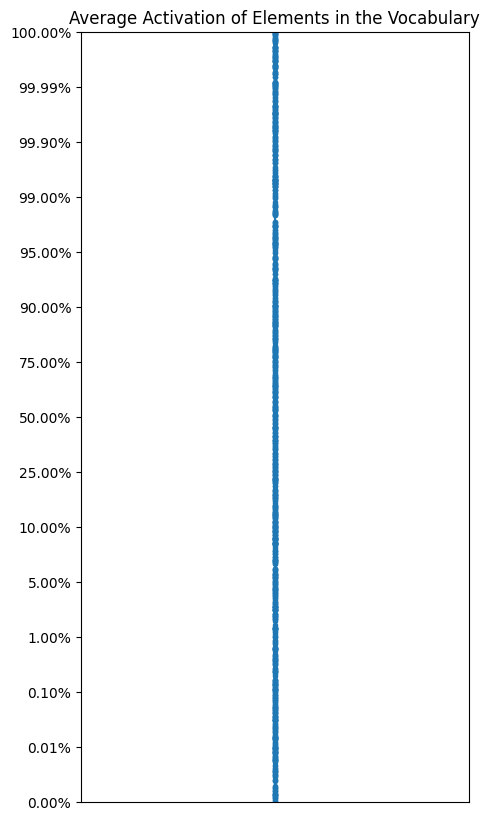

In [58]:
p = np.array([0.5, 0.75, 0.9, 0.95, 0.99, 0.999, 0.9999, 1])
np.concatenate([(1-p)[::-1], p[1:]])

array([0.000e+00, 1.000e-04, 1.000e-03, 1.000e-02, 5.000e-02, 1.000e-01,
       2.500e-01, 5.000e-01, 7.500e-01, 9.000e-01, 9.500e-01, 9.900e-01,
       9.990e-01, 9.999e-01, 1.000e+00])

In [68]:

#n = (11, 6389)
n=(8,2125)
#n=(8,4787)
#n=(12,1376)

non_pad_ix = ewt['tokens'] > 1
token_vec = ewt['tokens'][non_pad_ix].numpy()

feature_condition = ewt['eos'] == 1#torch.roll(ewt['eos'], -1, dims=1) # next token is eos
feature_label = feature_condition[non_pad_ix].numpy().astype(bool)

adf = pd.DataFrame({
    'token': token_vec,
    'string': [model.to_string(t) for t in token_vec],
    #'pos': einops.repeat(torch.arange(512), 'l -> b l', b=len(ewt))[non_pad_ix].numpy(),
    #'seq_ix': einops.repeat(torch.arange(len(ewt)), 'b -> b l', l=512)[non_pad_ix].numpy(),
    'activation': act_dict[n].dequantize().numpy()[non_pad_ix],
    #'eos': feature_label,
})

In [69]:
vocab_df = adf.groupby('string')['activation'].describe()


In [70]:
vocab_df.sort_values('mean', ascending=False)#.head(100)

,count,mean,std,min,25%,50%,75%,max
string,,,,,,,,
Olson,1.0,7.113743,NaN,7.113743,7.113743,7.113743,7.113743,7.113743
mes,1.0,5.858377,NaN,5.858377,5.858377,5.858377,5.858377,5.858377
shaw,1.0,5.858377,NaN,5.858377,5.858377,5.858377,5.858377,5.858377
She,1.0,5.701456,NaN,5.701456,5.701456,5.701456,5.701456,5.701456
SHE,7.0,5.574425,0.491478,4.759931,5.361461,5.596842,5.832223,6.276832
...,...,...,...,...,...,...,...,...
97,1.0,-3.609179,NaN,-3.609179,-3.609179,-3.609179,-3.609179,-3.609179
401,1.0,-3.661485,NaN,-3.661485,-3.661485,-3.661485,-3.661485,-3.661485
Fifty,1.0,-3.713792,NaN,-3.713792,-3.713792,-3.713792,-3.713792,-3.713792


In [77]:
vocab_df = vocab_df.reset_index()[['string', 'count', 'mean', '50%', 'max']].query('count > 2')

In [78]:
vocab_df.head(3)

,string,count,mean,50%,max
0,,23.0,-1.077978,-1.307673,1.883050
1,!,20.0,-1.121984,-1.098446,-0.313842
2,"""",791.0,-2.077068,-2.092278,0.523069


In [197]:
import matplotlib.pyplot as plt
import numpy as np

# Given average activations of every element in the vocabulary
avg_activations = vocab_df['mean'].values
vocab_strs = vocab_df['string'].values

# Sort and normalize the data
sorted_indices = np.argsort(avg_activations)
rank = np.arange(len(sorted_indices))[sorted_indices]
vocab_percentiles = rank / (len(sorted_indices) - 1)
n = len(vocab_percentiles)
# Define the percentiles for the plot
base = 20
p = np.logspace(-3, math.log(0.5) / math.log(base), 20, base=base)
percentiles = np.concatenate([p, (1-p)[1:][::-1]])

indices = [min(int(p * n), n-1) for p in percentiles]


In [198]:
# ticks = np.array([0.5, 0.9, 0.99, 0.999, 1])
# plot_ticks = np.concatenate([(1 - p)[::-1], p[1:]])

In [199]:
# log with base argument


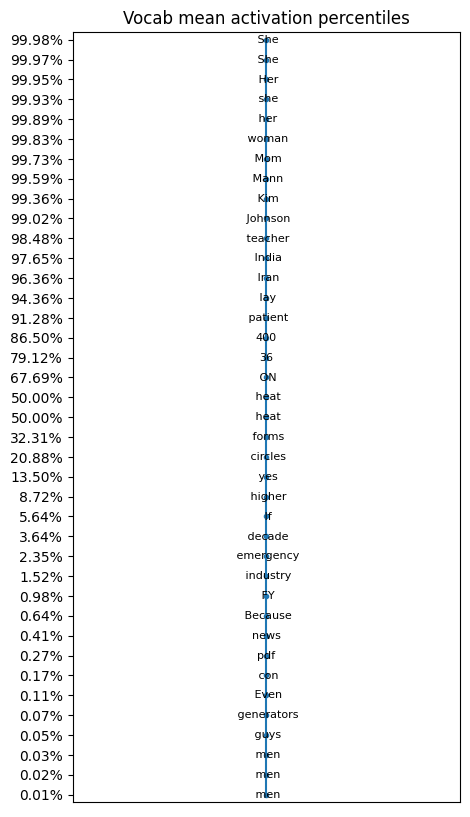

In [200]:
y_percentiles = np.sort(vocab_percentiles)[indices]
y_strs = vocab_strs[rank[indices]]

# Prepare the x-axis labels and positions
labels = [f"{p*100:.2f}%" for p in percentiles]


y_positions = np.linspace(0, 1, len(percentiles))

# Create the plot
fig, ax = plt.subplots(figsize=(5, 10))
ax.plot(np.ones(n)[indices], y_positions, linestyle='-', marker='o', markersize=3)

# Customize the plot
ax.set_xticks([])
ax.set_yticks(y_positions)
ax.set_yticklabels(labels)
ax.set_ylim(-0.01, 1.01)
ax.set_title("Vocab mean activation percentiles")

# Add strings centered on the markers
for i, txt in enumerate(y_strs):
    ax.text(1, y_positions[i], txt, ha='center', va='center', fontsize=8)

# Display the plot
plt.show()

In [178]:
y_positions

array([0.        , 0.02631579, 0.05263158, 0.07894737, 0.10526316,
       0.13157895, 0.15789474, 0.18421053, 0.21052632, 0.23684211,
       0.26315789, 0.28947368, 0.31578947, 0.34210526, 0.36842105,
       0.39473684, 0.42105263, 0.44736842, 0.47368421, 0.5       ,
       0.52631579, 0.55263158, 0.57894737, 0.60526316, 0.63157895,
       0.65789474, 0.68421053, 0.71052632, 0.73684211, 0.76315789,
       0.78947368, 0.81578947, 0.84210526, 0.86842105, 0.89473684,
       0.92105263, 0.94736842, 0.97368421, 1.        ])

In [176]:
import numpy as np
import matplotlib.pyplot as plt

# Dummy data (replace with your own data)
n = 10
vocab_percentiles = np.random.rand(n)
vocab_strs = np.array(["str" + str(i) for i in range(n)])
rank = np.argsort(vocab_percentiles)

# Specify desired ticks and number of points
ticks = np.array([0, 0.01, 0.1, 0.5, 0.9, 0.99, 1])
num_points = 20

# Convert ticks to logarithmic scale
log_ticks = np.log(ticks[1:-1])  # Avoid log(0) and log(1)

# Create equally spaced points in the logarithmic scale
log_points = np.linspace(log_ticks.min(), log_ticks.max(), num_points)

# Convert points back to the original scale
y_percentiles = np.concatenate(([0], np.exp(log_points), [1]))
indices = np.searchsorted(np.sort(vocab_percentiles), y_percentiles)
y_strs = vocab_strs[rank[indices]]

y_positions = np.linspace(0, 1, len(y_percentiles))

# Create the plot
fig, ax = plt.subplots(figsize=(5, 10))
ax.plot(np.ones(len(y_percentiles)), y_positions, linestyle='-', marker='o', markersize=3)

# Customize the plot
labels = [f"{p*100:.2f}%" for p in y_percentiles]

ax.set_xticks([])
ax.set_yticks(y_positions)
ax.set_yticklabels(labels)
ax.set_ylim(-0.01, 1.01)
ax.set_title("Vocab mean activation percentiles")

# Add strings centered on the markers
for i, txt in enumerate(y_strs):
    ax.text(1, y_positions[i], txt, ha='center', va='center', fontsize=8)

# Display the plot
plt.show()


IndexError: index 10 is out of bounds for axis 0 with size 10

In [166]:
indices

array([     0,   1015,   1277,   1601,   2035,   2607,   3323,   4238,
         5380,   6803,   8720,  11084,  14213,  18096,  23027,  29301,
        37386,  47746,  60635,  77529,  98927, 100000])

In [164]:
rank

array([6, 5, 8, 0, 3, 1, 2, 7, 4, 9])

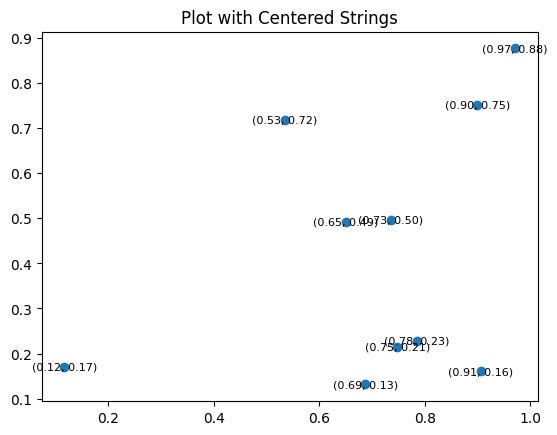

In [111]:
import matplotlib.pyplot as plt
import numpy as np

# Generate random data
x = np.random.rand(10)
y = np.random.rand(10)

# Strings to plot at each marker
strings = [f"({x:.2f}, {y:.2f})" for x, y in zip(x, y)]

# Create the plot
fig, ax = plt.subplots()

# Plot the markers
ax.scatter(x, y)

# Add strings centered on the markers
for i, txt in enumerate(strings):
    ax.text(x[i], y[i], txt, ha='center', va='center', fontsize=8)

# Customize the plot
ax.set_title("Plot with Centered Strings")

# Display the plot
plt.show()


In [76]:
indices

[0, 0, 3, 31, 157, 314, 787, 1574, 2361, 2834, 2991, 3117, 3145, 3148, 3148]

In [17]:
experiment_dir = 'results/all_activations/pythia-70m/preprocessed_ewt_512.hf/ewt_full'
activations, metadata = load_activation_all(experiment_dir)
layer_ix = 1
activations = gelu_fast(activations[layer_ix, :, :].to(torch.float32)).numpy().astype(np.float16)

In [20]:
nstd = activations.astype(np.float32).std(axis=1)

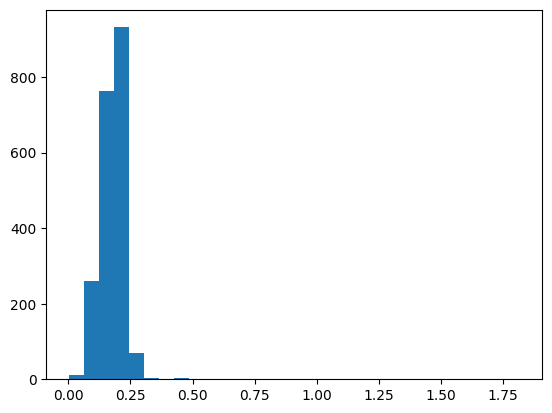

In [24]:
plt.hist(nstd, bins=30);

In [25]:
np.argsort(nstd)

array([  11, 1912, 1199, ..., 1296,  841,  437])

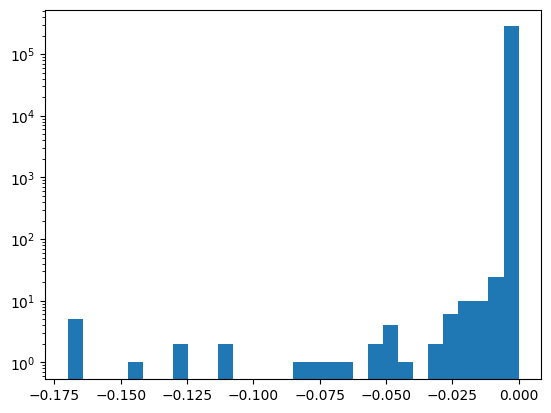

In [28]:
plt.hist(activations[11, :], bins=30);
plt.yscale('log')

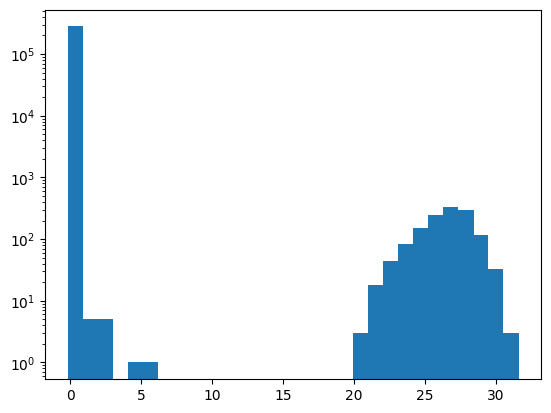

In [29]:
plt.hist(activations[437, :], bins=30);
plt.yscale('log');

(array([  3.,   2.,  65., 289., 129.,  19.,   3.,   0.,   1.,   1.]),
 array([0.82229733, 1.19323981, 1.56418216, 1.93512464, 2.30606699,
        2.67700958, 3.04795194, 3.41889429, 3.78983665, 4.160779  ,
        4.53172159]),
 <BarContainer object of 10 artists>)

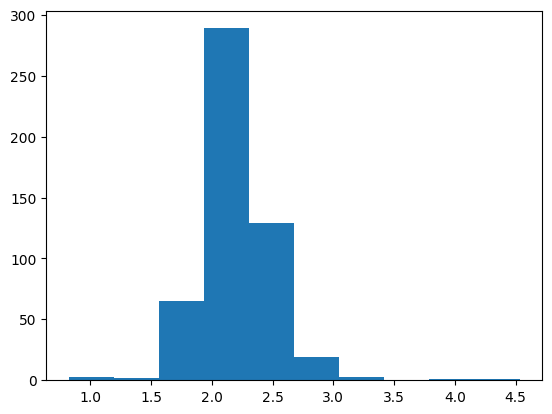

In [51]:
plt.hist(np.linalg.norm(model.W_in[1], axis=1))

In [53]:
np.linalg.norm(model.W_in[1, 437])

2.5990307

In [52]:
np.argsort(np.linalg.norm(model.W_in[1], axis=1))

array([156, 478,  23,  72,  98, 507, 173, 369,   9, 119, 113, 361, 106,
       477,  87, 214, 270, 211,  79, 250, 457,   2, 295, 345, 317, 196,
       488, 109, 502, 397, 101, 396, 247, 256, 164, 486, 380, 231, 392,
       406, 467,  89, 236, 443,  26, 473, 166,  73, 376, 410, 363, 348,
       378, 321, 128, 260, 140, 350,  22, 299, 125, 500,  52, 241, 365,
       191, 202, 485, 182, 503, 298, 303,  77,  28,   0, 276, 415, 338,
       495, 130, 268, 209,  69, 334, 381, 394, 269, 244, 474,  42, 150,
       432, 100, 408,  14,  96,  27,   8,  81, 144,  21, 232, 351, 165,
       454, 356, 154, 463, 117, 210, 200, 308, 221, 158, 471, 445, 142,
        51, 172, 124, 389, 192,  18,  88, 201, 160, 213, 494, 444, 367,
       371, 448,  59, 446, 193, 452, 315, 489, 262, 359,  17, 456, 375,
       203, 162, 159,  70, 377, 188,  58, 205, 228, 434, 316,  13, 372,
       421, 470, 245, 283, 174, 246,  53, 462, 490, 155, 450, 118, 352,
       510, 384, 189, 249, 123,  66,  12, 302, 184,  43, 233, 49

In [31]:
stim437 = activations[437, :] > 10

In [39]:
token_vec = ewt['tokens'][ewt['tokens'] > 1].numpy()

non_pad_ix = ewt['tokens'] > 1
feature_condition = ewt['eos'] == 1#torch.roll(ewt['eos'], -1, dims=1) # next token is eos
feature_label = feature_condition[non_pad_ix].numpy().astype(bool)

adf = pd.DataFrame({
    'token': token_vec,
    'string': [model.to_string(t) for t in token_vec],
    'pos': einops.repeat(torch.arange(512), 'l -> b l', b=len(ewt))[ewt['tokens'] > 1].numpy(),
    'seq_ix': einops.repeat(torch.arange(len(ewt)), 'b -> b l', l=512)[ewt['tokens'] > 1].numpy(),
    'activation': activations[437, :],
    'stim437': activations[437, :] > 10,
    'eos': feature_label,
})

In [41]:
adf.groupby(['stim437', 'eos']).size()

stim437  eos  
False    False    267913
         True      11808
True     False       137
         True       1186
dtype: int64

In [47]:
adf.loc[adf.stim437].groupby('seq_ix').size().value_counts()

1    1323
dtype: int64

In [156]:
import einops
neuron_output_effect = einops.einsum(model.W_out, model.W_U, 'l n d, d t -> l n t').numpy().astype(np.float16)

In [159]:
neuron_output_effect = einops.rearrange(neuron_output_effect, 'l n t -> (l n) t')

In [158]:
eos_ts = np.array([idecoded_vocab['.'], idecoded_vocab['!'], idecoded_vocab['?']])

In [164]:
eos_bit_array = np.zeros(neuron_output_effect.shape[1], dtype=bool)
eos_bit_array[eos_ts] = 1
max_diff = neuron_output_effect[:, eos_bit_array].mean(axis=1) - neuron_output_effect[:, ~eos_bit_array].mean(axis=1).mean()

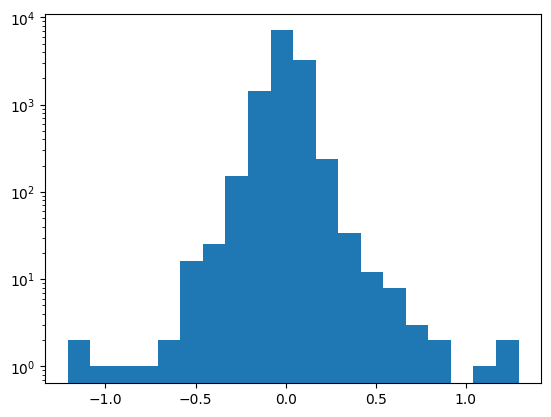

In [168]:
plt.hist(max_diff, bins=20)
plt.yscale('log')

In [171]:
np.argsort(max_diff)[-10:] % 2048, np.argsort(max_diff)[-10:] // 2048

(array([1480,  196,  900, 1830, 1754, 1912, 1800, 1237, 1500,   11]),
 array([4, 4, 5, 4, 4, 1, 5, 5, 4, 1]))

In [213]:
nstds = activations.astype(np.float32).std(axis=1)

(array([886., 949., 166.,  34.,   6.,   2.,   3.,   1.,   0.,   1.]),
 array([0.03489023, 0.2255137 , 0.41613716, 0.60676062, 0.79738408,
        0.98800755, 1.17863095, 1.36925447, 1.55987787, 1.75050139,
        1.9411248 ]),
 <BarContainer object of 10 artists>)

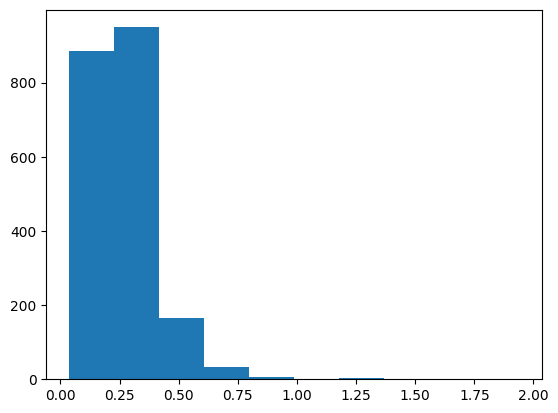

In [216]:
plt.hist(nstds)

In [135]:
def plot_class_hists(activations, class_dict, nix):
    _, bins = np.histogram(activations[nix], bins=50)
    for cls, label in class_dict.items():
        class_count, _ = np.histogram(activations[nix, label], bins=bins)
        class_dist = class_count / class_count.sum()
        plt.hist(bins[:-1], bins, weights=class_dist, label=cls, alpha=0.5)
    plt.legend()
    #plt.yscale('log')
    plt.ylim(0, 0.25)

In [136]:
ewt

Dataset({
    features: ['Number', 'Mood', 'Tense', 'VerbForm', 'PronType', 'Person', 'NumType', 'Voice', 'Gender', 'eos', 'upos', 'dep', 'head', 'within_compound_token_ix', 'max_compound_token_ix', 'tokens', 'doc_id', 'split'],
    num_rows: 1438
})

In [137]:
ewt['Number']

tensor([[0, 1, 0,  ..., 0, 0, 0],
        [0, 2, 2,  ..., 0, 0, 0],
        [0, 0, 1,  ..., 0, 0, 0],
        ...,
        [0, 0, 1,  ..., 0, 0, 0],
        [0, 0, 1,  ..., 0, 0, 0],
        [0, 0, 1,  ..., 0, 0, 0]])

In [173]:
non_pad_ix = ewt['tokens'] > 1
feature_condition = torch.roll(ewt['eos'], -1, dims=1) # next token is eos
negative = ~feature_condition
pos_feature = feature_condition[non_pad_ix].numpy().astype(bool)
negative_feature = negative[non_pad_ix].numpy().astype(bool)
mean_dif = activations[:, pos_feature].mean(axis=1) - activations[:, ~pos_feature & negative_feature].mean(axis=1)

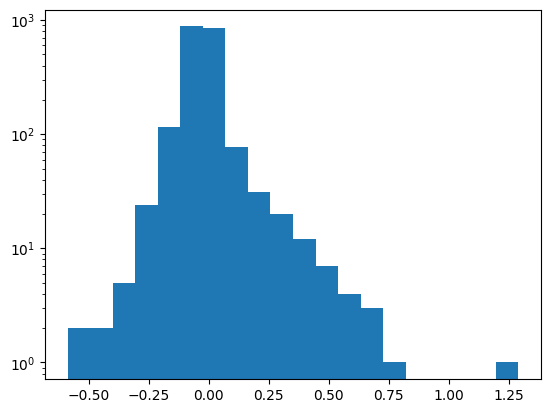

In [174]:
plt.hist(mean_dif, bins=20)
plt.yscale('log')

In [177]:
np.argsort(mean_dif)[-5:], 1800, 1237

array([1784, 1610, 1940, 1592,  188])

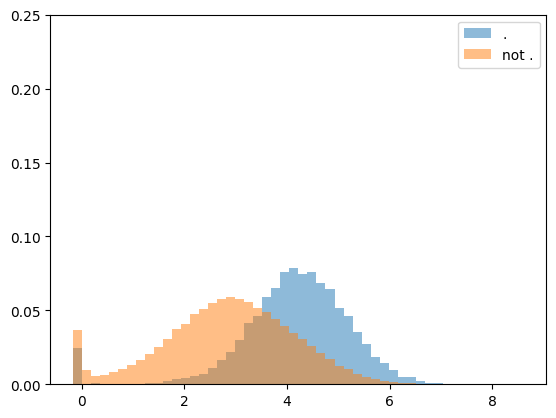

In [187]:
plot_class_hists(activations, {'.': pos_feature, 'not .': ~pos_feature & negative_feature}, 188)

In [194]:
act_freq = (activations > 0.1).mean(axis=1)

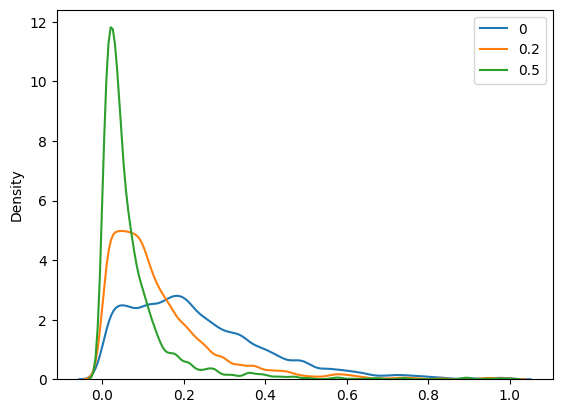

In [206]:
ax = sns.kdeplot((activations > 0).mean(axis=1), bw_adjust=.5, label='0')
sns.kdeplot((activations > 0.2).mean(axis=1), bw_adjust=.5, ax=ax, label='0.2')
sns.kdeplot((activations > 0.5).mean(axis=1), bw_adjust=.5, ax=ax, label='0.5')
plt.legend()

In [99]:
ewt['Voice']

tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]])

In [107]:
non_pad_ix = ewt['tokens'] > 1
feature_condition = ewt['Voice'] == 1#torch.roll(ewt['eos'], -1, dims=1) # next token is eos
verbs = ewt['upos'] == 17
pos_feature = feature_condition[non_pad_ix].numpy().astype(bool)
verb_feature = verbs[non_pad_ix].numpy().astype(bool)
verb_mean_dif = activations[:, pos_feature].mean(axis=1) - activations[:, ~pos_feature & verb_feature].mean(axis=1)
all_mean_dif = activations[:, pos_feature].mean(axis=1) - activations[:, ~pos_feature].mean(axis=1)

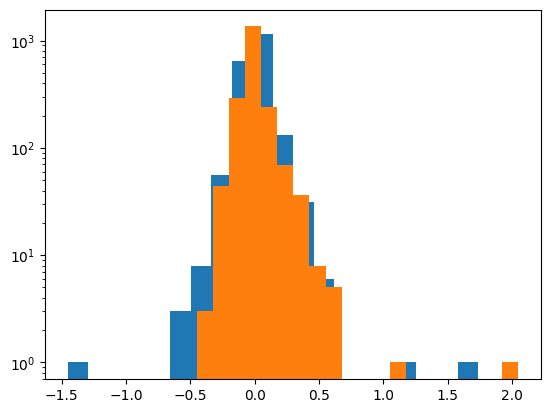

In [108]:
plt.hist(verb_mean_dif, bins=20)
plt.hist(all_mean_dif, bins=20)
plt.yscale('log')

In [109]:
np.argmax(verb_mean_dif), np.argmax(all_mean_dif), np.argmin(verb_mean_dif), np.argmin(all_mean_dif)

(383, 383, 1730, 1459)

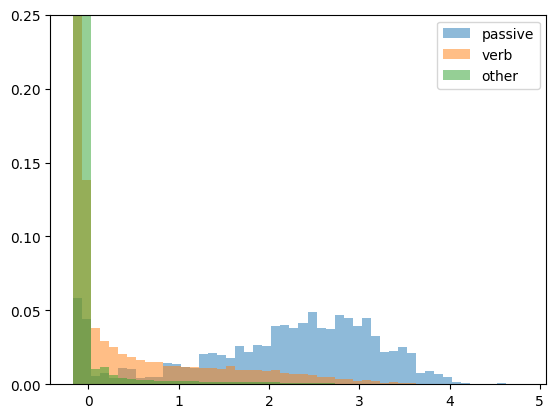

In [118]:
plot_class_hists(activations, {'passive': pos_feature, 'verb': verb_feature & ~pos_feature, 'other': ~verb_feature}, 383)

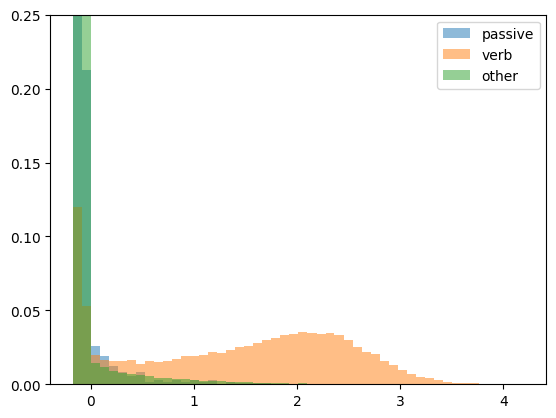

In [119]:
plot_class_hists(activations, {'passive': pos_feature, 'verb': verb_feature & ~pos_feature, 'other': ~verb_feature}, 1730)

In [100]:
non_pad_ix = ewt['tokens'] > 1
feature_condition = ewt['eos'] == 1#torch.roll(ewt['eos'], -1, dims=1) # next token is eos
feature_label = feature_condition[non_pad_ix].numpy().astype(bool)
mean_dif = activations[:, feature_label].mean(axis=1) - activations[:, ~feature_label].mean(axis=1)

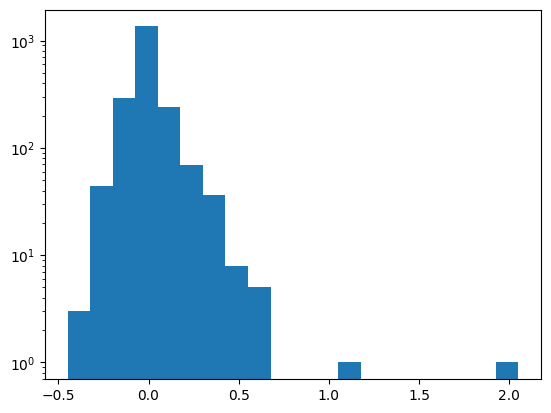

In [101]:
plt.hist(mean_dif, bins=20)
plt.yscale('log')

In [102]:
nix = np.argmax(mean_dif)

(0.0, 0.25)

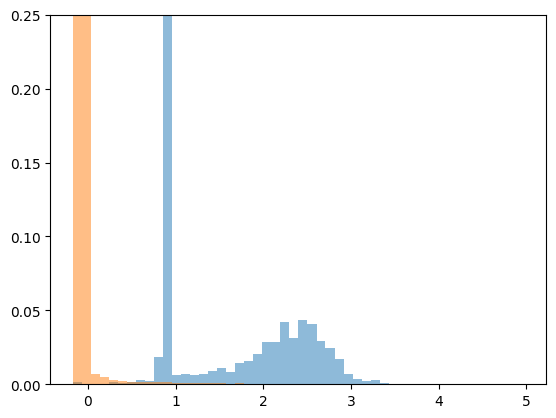

In [97]:
label = eos
_, bins = np.histogram(activations, bins=50)
count_pos, _ = np.histogram(activations[nix, label], bins=bins)
count_neg, _ = np.histogram(activations[nix, ~label], bins=bins)
dist_pos = count_pos / count_pos.sum()
dist_neg = count_neg / count_neg.sum()

plt.hist(bins[:-1], bins, weights=dist_pos, label='eos', alpha=0.5)
plt.hist(bins[:-1], bins, weights=dist_neg, label='not', alpha=0.5);
plt.ylim(0, 0.25)

(0.0, 0.25)

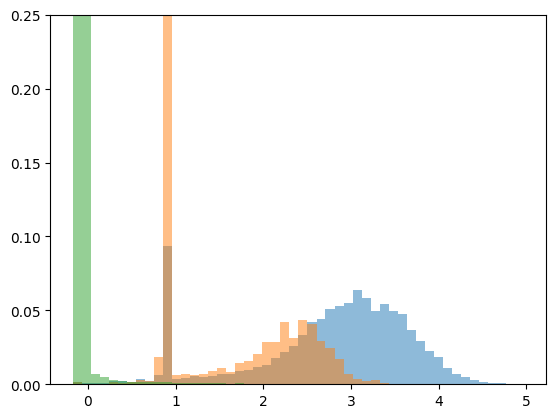

In [98]:
label = adf.eos.values
first_eos = adf.first_eos.values
_, bins = np.histogram(activations[nix, :], bins=50)
count_pos, _ = np.histogram(activations[nix, label], bins=bins)
count_special, _ = np.histogram(activations[nix, first_eos], bins=bins)
count_neg, _ = np.histogram(activations[nix, ~label], bins=bins)
dist_pos = count_pos / count_pos.sum()
dist_special = count_special / count_special.sum()
dist_neg = count_neg / count_neg.sum()

plt.hist(bins[:-1], bins, weights=dist_pos, label='eos', alpha=0.5)
plt.hist(bins[:-1], bins, weights=dist_special, label='first_eos', alpha=0.5)
plt.hist(bins[:-1], bins, weights=dist_neg, label='not', alpha=0.5);
plt.ylim(0, 0.25)

In [72]:
np.argmax(count_pos)

10

,token,string,pos,seq_ix,activation,eos,first_eos
0,1219,Al,1,0,-0.107849,False,False
1,14,-,2,0,-0.051178,False,False
2,59,Z,3,0,-0.061066,False,False
3,14990,aman,4,0,-0.093506,False,False
4,1163,:,5,0,0.443115,False,False
...,...,...,...,...,...,...,...
281039,7738,suggesting,53,1437,-0.089844,False,False
281040,18418,exercises,54,1437,-0.136719,False,False
281041,281,to,55,1437,-0.059662,False,False
281042,897,use,56,1437,-0.163208,False,False


In [95]:
token_vec = ewt['tokens'][ewt['tokens'] > 1].numpy()

adf = pd.DataFrame({
    'token': token_vec,
    'string': [model.to_string(t) for t in token_vec],
    'pos': einops.repeat(torch.arange(512), 'l -> b l', b=len(ewt))[ewt['tokens'] > 1].numpy(),
    'seq_ix': einops.repeat(torch.arange(len(ewt)), 'b -> b l', l=512)[ewt['tokens'] > 1].numpy(),
    'activation': activations[nix],
    'eos': feature_label
})
first_eos_ix = adf.query('eos == True').groupby('seq_ix').pos.min().to_dict()
adf['first_eos'] = adf.apply(lambda row: row.pos == first_eos_ix.get(row.seq_ix, 1e10), axis=1)

In [80]:
from circuitsvis.tokens import colored_tokens
ix = 3
token_list = adf.query('seq_ix==@ix')['string'].values.tolist()
activation_list = adf.query('seq_ix==@ix')['activation'].values.tolist()

colored_tokens(token_list, activation_list)

In [64]:
layer_ix, nix = 4, 1186
output_weight = model.W_out[layer_ix, nix, :]
dim_tokens = np.array([decoded_vocab.get(i, 'unk') for i in range(model.W_U.shape[1])])

logit_attribution = (model.W_U.T @ output_weight).numpy()

(array([  4.,   1.,   3.,   7.,  18.,  51., 112., 236., 447., 610., 595.,
        469., 285., 130.,  70.,  26.,   9.,   6.,   3.,   1.]),
 array([-0.42243218, -0.37659088, -0.3307496 , -0.28490829, -0.23906699,
        -0.1932257 , -0.14738441, -0.1015431 , -0.0557018 , -0.00986051,
         0.03598079,  0.08182209,  0.12766339,  0.17350468,  0.21934599,
         0.26518726,  0.31102857,  0.35686988,  0.40271118,  0.44855246,
         0.49439377]),
 <BarContainer object of 20 artists>)

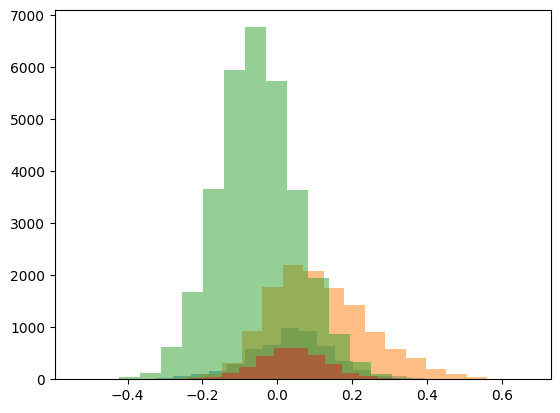

In [52]:
text_tokens = np.array([len(t.strip()) > 0 and t.strip()[0].isalpha() for t in dim_tokens])
cap_tokens = np.array([len(t.strip()) > 0 and t.strip()[0].isupper() for t in dim_tokens])
low_tokens = np.array([len(t.strip()) > 0 and t.strip()[0].islower() for t in dim_tokens])
# all caps tokens
all_cap_tokens = np.array([len(t.strip()) > 0 and t.strip().isupper() for t in dim_tokens])

plt.hist(logit_attribution[~text_tokens], bins=20, alpha=0.5, label='non-text')
plt.hist(logit_attribution[cap_tokens], bins=20, alpha=0.5, label='cap')
plt.hist(logit_attribution[low_tokens], bins=20, alpha=0.5, label='low')
plt.hist(logit_attribution[all_cap_tokens], bins=20, alpha=0.5, label='all cap')

In [41]:
np.array(dim_tokens)[np.argsort((model.W_U.T @ output_weight).numpy())]

array([' itself', ' terms', 'ensit', ..., ' Some', ' Previous', ' Used'],
      dtype='<U512')

In [ ]:
0.8584, 0.9614

In [77]:
adf.query('activation > 0.8584 and activation < 0.9614 and eos==True and token==15').head(50)

,token,string,pos,seq_ix,activation,eos
32,15,.,33,0,0.906250,True
519,15,.,20,1,0.905273,True
989,15,.,20,2,0.908203,True
1488,15,.,83,3,0.897461,True
1941,15,.,25,4,0.933105,True
2502,15,.,91,5,0.939453,True
2960,15,.,82,6,0.913574,True
3414,15,.,31,7,0.907227,True
4516,15,.,114,9,0.910156,True
4953,15,.,49,10,0.924316,True


In [90]:
adf.query('activation > 0.8584 and activation < 0.9614')

,token,string,pos,seq_ix,activation,eos,first_eos
32,15,.,33,0,0.906250,True,True
53,27,:,54,0,0.919922,False,False
519,15,.,20,1,0.905273,True,True
989,15,.,20,2,0.908203,True,True
1488,15,.,83,3,0.897461,True,True
...,...,...,...,...,...,...,...
280773,15,.,34,1433,0.926270,True,True
280822,15,.,23,1434,0.906250,True,False
280888,15,.,25,1435,0.920898,True,False
280940,15,.,19,1436,0.916992,True,True


15

(15, 2, 32)

In [143]:
(50_000 * 2048 * 6 * 2) / 2**30

1.1444091796875

In [146]:
model.W_U.shape

torch.Size([512, 50304])

In [147]:
einops.reshape(model.W_out, 'l n d -> (l n)')#.shape

torch.Size([6, 2048, 512])

In [5]:
from load import *
from analysis.load_results import *

In [6]:
def make_heuristic_probing_results_df(results_dict):
    flattened_results = {}
    for key in results_dict:
        for sparsity in results_dict[key]:
            flattened_results[key + (sparsity, )
                                ] = results_dict[key][sparsity]
    rdf = pd.DataFrame(flattened_results).T.sort_index().rename_axis(
        index=['feature', 'layer', 'aggregation', 'hook_loc', 'k'])
    return rdf

results_dir = 'results'
experiment_name = 'ewt_test'
model_name = 'pythia-70m'
dataset_name = 'ewt.pyth.512.-1'
inner_loop = 'fast_heuristic_sparsity_sweep'

model_sizes = ['70m', '160m', '410m', '1b', '1.4b']
rdfs = []
for size in model_sizes:
    results = load_probing_experiment_results(results_dir, experiment_name, f'pythia-{size}', dataset_name, inner_loop, uncollapse_features=True)
    rdf = make_heuristic_probing_results_df(results).query('aggregation == "none"')

    verbose_features = []
    for k in rdf.index.get_level_values('feature'):
        fname = k[4:]  # get rid of all
        next_token = False
        if fname[:len('next_token_')] == 'next_token_':
            fname = fname[len('next_token_'):]
            next_token = True
        fclass, ftype = fname.split('_')
        verbose_features.append((size, fclass, ftype, next_token))

    # add verbose features to index of rdf
    rdf.index = pd.MultiIndex.from_tuples(
        [k2 + k1[1:] for k1, k2 in zip(rdf.index.values.T.tolist(), verbose_features)],
        names=['size', 'feature_class', 'feature_type', 'next_token'] + rdf.index.names[1:])

    rdfs.append(rdf)


In [7]:
all_df = pd.concat(rdfs).drop(columns=['test_precision_curve', 'test_recall_curve', 'test_f0.5_score', 'test_f2_score', 'test_acc', 'test_roc_auc'])

In [8]:
# fade (linear interpolate) from color c1 (at mix=0) to c2 (mix=1)
import matplotlib as mpl
def colorFader(c1='red', c2='blue', mix=0):
    c1 = np.array(mpl.colors.to_rgb(c1))
    c2 = np.array(mpl.colors.to_rgb(c2))
    return mpl.colors.to_hex((1-mix)*c1 + mix*c2)

def plot_feature_summary(all_df, feature_class, feature_type, perf_metric, model_sizes):
    n_models = len(model_sizes)
    fig, axs = plt.subplots(2, n_models, figsize=(n_models * 3, 6), sharex=True, sharey=True)
    # plot f1 per layer for each model, top row for next_token=False and bottom row for next_token=True
    plot_df = all_df.query('feature_class==@feature_class and feature_type==@feature_type').sort_index()
    for i, size in enumerate(model_sizes):
        model_df = plot_df.query('size==@size')
        layers = model_df.index.get_level_values('layer').unique()
        for j, next_token in enumerate([False, True]):
            ax = axs[j, i]
            for l in layers:
                line_df = model_df.query('layer==@l and next_token==@next_token')
                sparsity = line_df.index.get_level_values('k').values
                perf = line_df[perf_metric].values
                ax.plot(sparsity, perf, label=f'{l}', color=colorFader(mix=l/len(layers)))
            ax.legend(loc='lower right', ncol=4, prop={'size': 5})
            token_label = 'next token' if next_token else 'current token'
            ax.set_xscale('log')
            ax.grid()
            if j == 1:
                ax.set_xlabel(f'sparsity (pythia-{size})')
            if i == 0:
                ax.set_ylabel(f'{perf_metric[5:]} for {token_label}')
    plt.suptitle(f'{feature_class} {feature_type} sparse probe performance')
    plt.tight_layout()
    plt.show()
    return fig, axs


In [16]:
all_df.query('size=="70m" and k==1 and layer==1').sort_values('test_mcc')

test_mcc  \
size feature_class feature_type next_token layer aggregation hook_loc      k             
70m  Gender        Fem          False      1     none        mlp.hook_post 1       0.0   
                   Masc         False      1     none        mlp.hook_post 1       0.0   
                   Neut         False      1     none        mlp.hook_post 1       0.0   
     Person        1            False      1     none        mlp.hook_post 1       0.0   
     VerbForm      Part         False      1     none        mlp.hook_post 1       0.0   
...                                                                                ...   
     PronType      Int          False      1     none        mlp.hook_post 1  0.744063   
                   Rel          False      1     none        mlp.hook_post 1  0.777928   
     upos          CCONJ        False      1     none        mlp.hook_post 1  0.780139   
     eos           True         False      1     none        mlp.hook_post 1  0.833328   
     Person        2            False      1     none        mlp.hook_post 1  0.906812   

                                                                             test_cohen_kappa  \
size feature_class feature_type next_token layer aggregation hook_loc      k                    
70m  Gender        Fem          False      1     none        mlp.hook_post 1              0.0   
                   Masc         False      1     none        mlp.hook_post 1              0.0   
                   Neut         False      1     none        mlp.hook_post 1              0.0   
     Person        1            False      1     none        mlp.hook_post 1              0.0   
     VerbForm      Part         False      1     none        mlp.hook_post 1              0.0   
...                                                                                       ...   
     PronType      Int          False      1     none        mlp.hook_post 1         0.731009   
                   Rel          False      1     none        mlp.hook_post 1         0.777187   
     upos          CCONJ        False      1     none        mlp.hook_post 1         0.779559   
     eos           True         False      1     none        mlp.hook_post 1         0.830242   
     Person        2            False      1     none        mlp.hook_post 1         0.906802   

                                                                              test_fmi  \
size feature_class feature_type next_token layer aggregation hook_loc      k             
70m  Gender        Fem          False      1     none        mlp.hook_post 1  0.338889   
                   Masc         False      1     none        mlp.hook_post 1       0.0   
                   Neut         False      1     none        mlp.hook_post 1       0.0   
     Person        1            False      1     none        mlp.hook_post 1   0.46341   
     VerbForm      Part         False      1     none        mlp.hook_post 1       0.0   
...                                                                                ...   
     PronType      Int          False      1     none        mlp.hook_post 1   0.76343   
                   Rel          False      1     none        mlp.hook_post 1  0.791612   
     upos          CCONJ        False      1     none        mlp.hook_post 1  0.823646   
     eos           True         False      1     none        mlp.hook_post 1  0.863686   
     Person        2            False      1     none        mlp.hook_post 1  0.920671   

                                                                             test_f1_score  \
size feature_class feature_type next_token layer aggregation hook_loc      k                 
70m  Gender        Fem          False      1     none        mlp.hook_post 1       0.20603   
                   Masc         False      1     none        mlp.hook_post 1           0.0   
                   Neut         False      1     none        mlp.hook_post 1           0.0   
    

In [15]:
all_df.query('feature_class == "Gender" and feature_type == "Masc" and k==1 and layer <=8 and next_token == False').sort_index()

test_mcc  \
size feature_class feature_type next_token layer aggregation hook_loc      k             
1.4b Gender        Masc         False      0     none        mlp.hook_post 1  0.993939   
                                           1     none        mlp.hook_post 1  0.907341   
                                           2     none        mlp.hook_post 1  0.780997   
                                           3     none        mlp.hook_post 1       0.0   
                                           4     none        mlp.hook_post 1   0.69665   
                                           5     none        mlp.hook_post 1       0.0   
                                           6     none        mlp.hook_post 1  0.938455   
                                           7     none        mlp.hook_post 1  0.715058   
                                           8     none        mlp.hook_post 1  0.684957   
160m Gender        Masc         False      0     none        mlp.hook_post 1  0.981865   
                                           1     none        mlp.hook_post 1  0.904425   
                                           2     none        mlp.hook_post 1       0.0   
                                           3     none        mlp.hook_post 1  0.813357   
                                           4     none        mlp.hook_post 1  0.762536   
                                           5     none        mlp.hook_post 1  0.625271   
                                           6     none        mlp.hook_post 1  0.588997   
                                           7     none        mlp.hook_post 1  0.757708   
                                           8     none        mlp.hook_post 1  0.996968   
1b   Gender        Masc         False      0     none        mlp.hook_post 1  0.996968   
                                           1     none        mlp.hook_post 1  0.971293   
                                           2     none        mlp.hook_post 1       0.0   
                                           3     none        mlp.hook_post 1       0.0   
                                           4     none        mlp.hook_post 1   0.73297   
                                           5     none        mlp.hook_post 1  0.609407   
                                           6     none        mlp.hook_post 1   0.72574   
                                           7     none        mlp.hook_post 1  0.715551   
                                           8     none        mlp.hook_post 1   0.98943   
410m Gender        Masc         False      0     none        mlp.hook_post 1       1.0   
                                           1     none        mlp.hook_post 1  0.879765   
                                           2     none        mlp.hook_post 1  0.773165   
                                           3     none        mlp.hook_post 1       0.0   
                                           4     none        mlp.hook_post 1  0.675458   
                                           5     none        mlp.hook_post 1       0.0   
                                           6     none        mlp.hook_post 1       0.0   
                                           7     none        mlp.hook_post 1  0.679256   
                                           8     none        mlp.hook_post 1  0.652221   
70m  Gender        Masc         False      0     none        mlp.hook_post 1  0.981865   
                                           1     none        mlp.hook_post 1       0.0   
                                           2     none        mlp.hook_post 1       0.0   
                                           3     none        mlp.hook_post 1   0.64019   
                                           4     none        mlp.hook_post 1  0.780685   
                                           5     none        mlp.hook_post 1  0.843419   

                                                                             test_cohen_kappa  \
size feature_class f

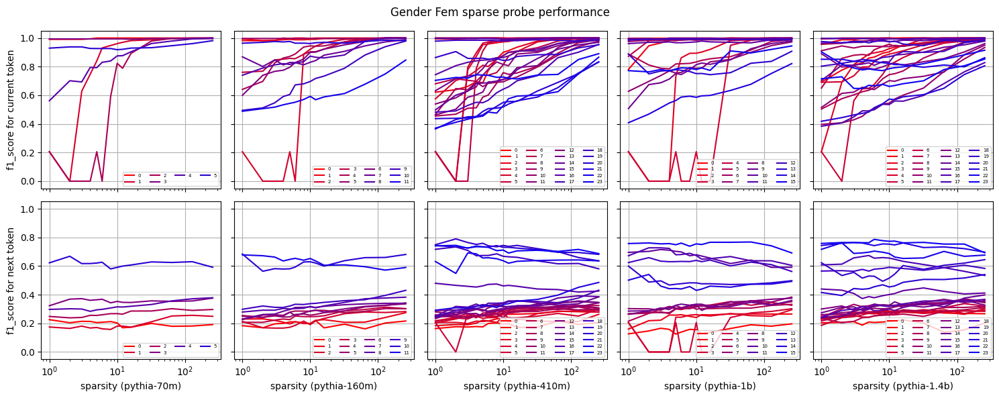

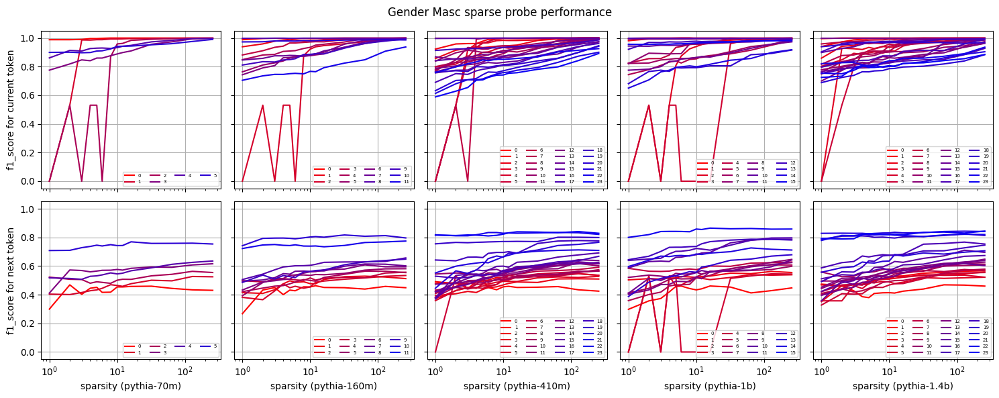

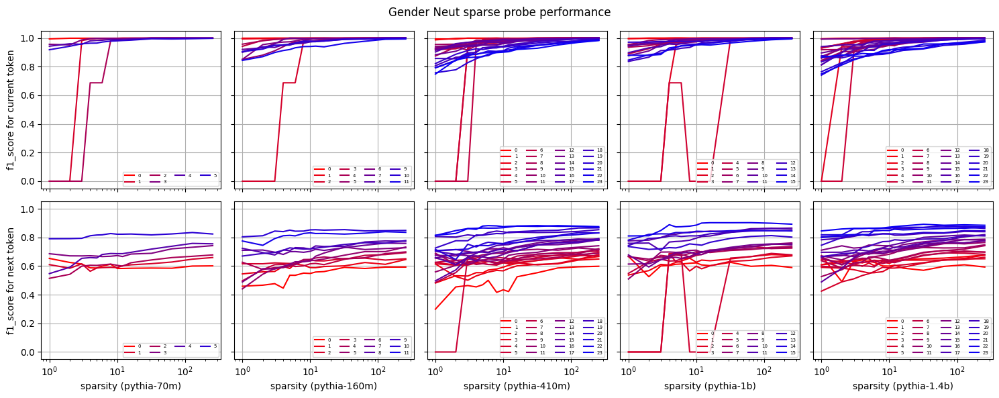

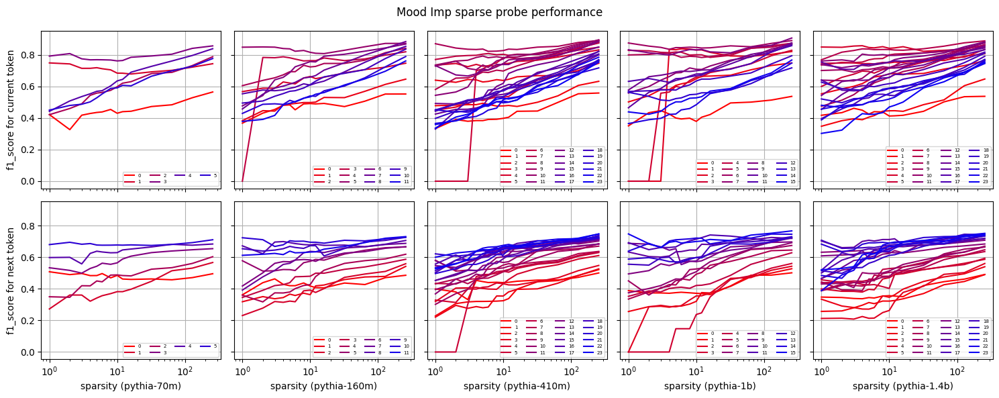

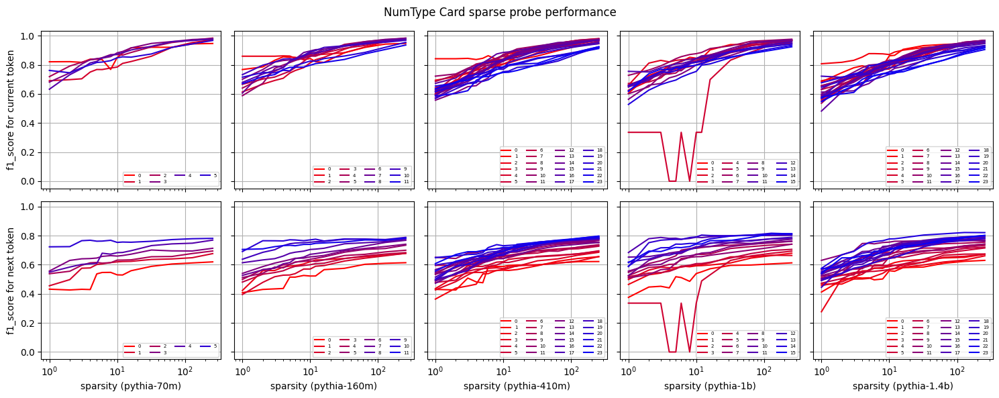

...

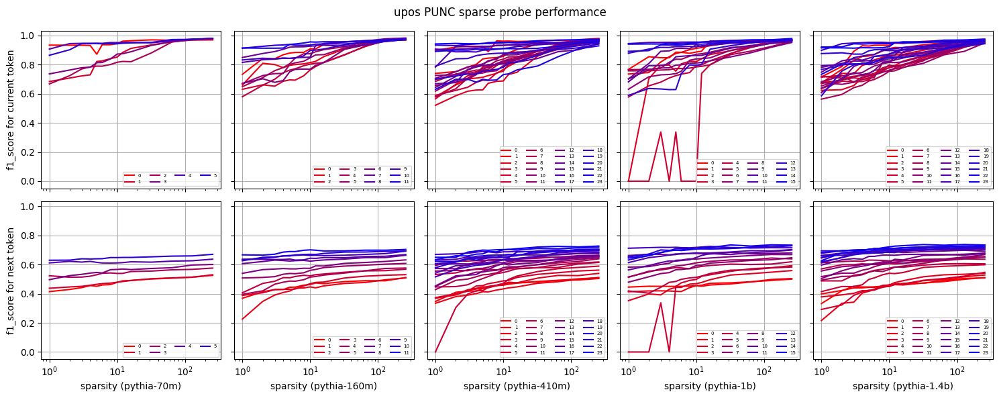

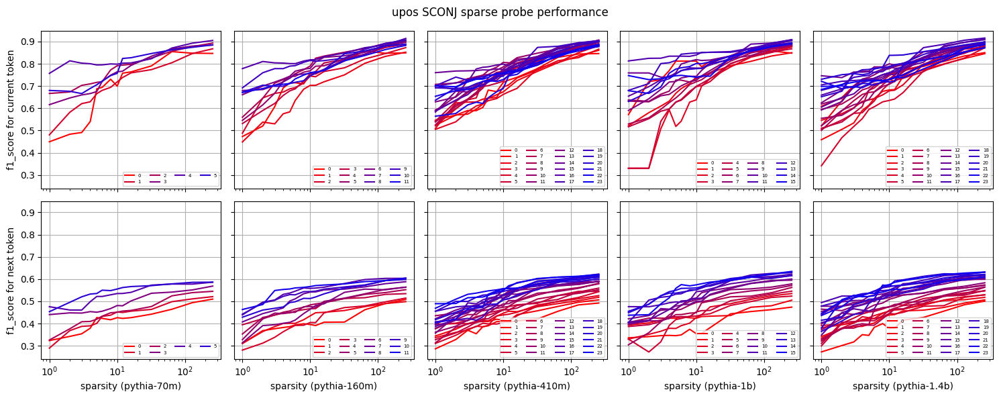

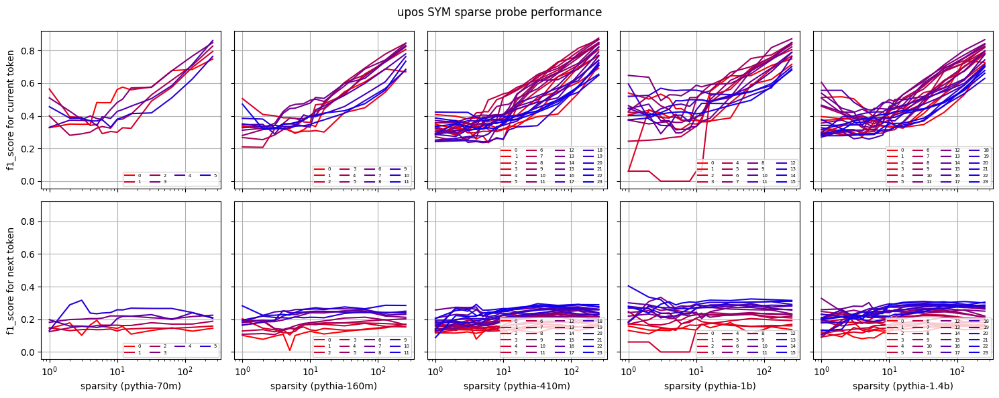

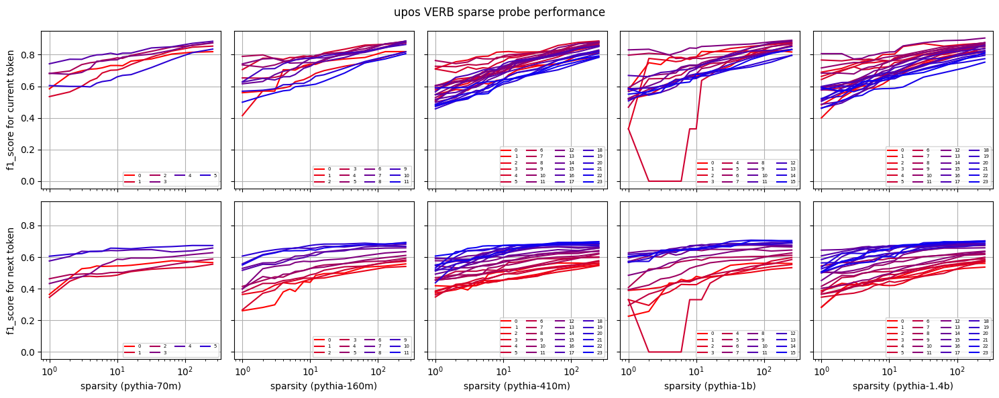

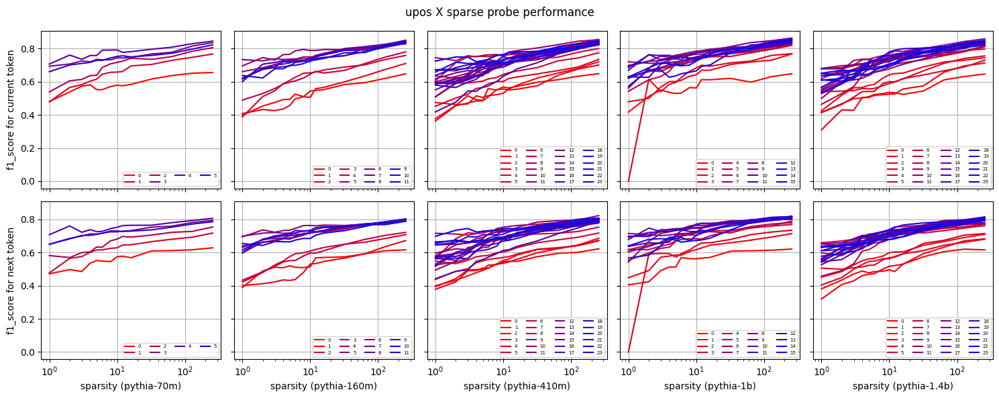

In [9]:
perf_metric = 'test_f1_score'

# plot_feature_summary for all feature classes and types
for feature_class in all_df.index.get_level_values('feature_class').unique():
    for feature_type in all_df.query('feature_class == @feature_class').index.get_level_values('feature_type').unique():
        fig, axs = plot_feature_summary(all_df, feature_class, feature_type, perf_metric, model_sizes)


In [135]:
# sort by index so that layers are in order
all_df.query('size==@size and feature_class==@feature_class and feature_type==@feature_type and next_token==@next_token').sort_index().index.get_level_values('layer')

Int64Index([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
            ...
            23, 23, 23, 23, 23, 23, 23, 23, 23, 23],
           dtype='int64', name='layer', length=336)

In [139]:
line_df

test_mcc  \
size feature_class feature_type next_token layer aggregation hook_loc      k               
1.4b Gender        Fem          False      5     none        mlp.hook_post 1         0.0   
                                                                           2         0.0   
                                                                           3    0.504874   
                                                                           4    0.610287   
                                                                           5    0.614389   
                                                                           6     0.64814   
                                                                           8    0.720404   
                                                                           10   0.793722   
                                                                           12   0.813991   
                                                                           16   0.848192   
                                                                           32   0.914643   
                                                                           64   0.959514   
                                                                           128  0.976346   
                                                                           256  0.993171   
                                True       5     none        mlp.hook_post 1    0.037979   
                                                                           2    0.104113   
                                                                           3    0.112538   
                                                                           4    0.131398   
                                                                           5    0.149998   
                                                                           6    0.149998   
                                                                           8    0.191438   
                                                                           10    0.17175   
                                                                           12   0.164326   
                                                                           16   0.161018   
                                                                           32   0.188077   
                                                                           64   0.167379   
                                                                           128  0.173606   
                                                                           256    0.1692   

                                                                               test_cohen_kappa  \
size feature_class feature_type next_token layer aggregation hook_loc      k                      
1.4b Gender        Fem          False      5     none        mlp.hook_post 1                0.0   
                                                                           2                0.0   
                                                                           3           0.493282   
                                                                           4            0.58612   
                                                                           5            0.58968   
                                                                           6           0.622074   
                                                                           8           0.707844   
                                                                           10          0.786677   
                                                                           12          0.806151   
                                                                           16          0.844053   
                                                                           32          0.913654   
                                

In [26]:
rdf = make_heuristic_probing_results_df(results).query('aggregation != "random"')

Text(0.5, 0, 'test_f1_score')

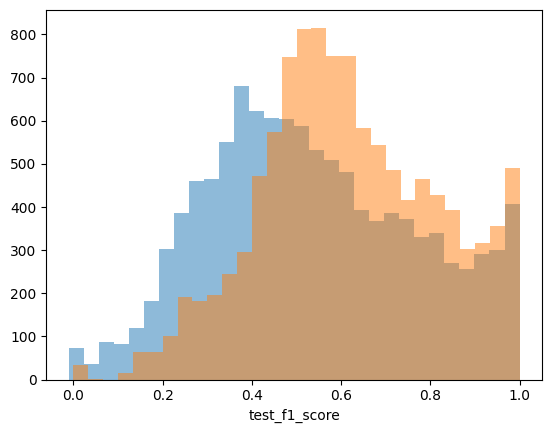

In [102]:
plt.hist(rdf.test_mcc.values, bins=30, alpha=0.5)
plt.hist(rdf.test_f1_score.values, bins=30, alpha=0.5)

plt.xlabel('test_f1_score')

In [107]:
rdf.columns

Index(['test_mcc', 'test_cohen_kappa', 'test_fmi', 'test_f1_score',
       'test_f0.5_score', 'test_f2_score', 'test_pr_auc', 'test_acc',
       'test_balanced_acc', 'test_precision', 'test_recall',
       'test_average_precision', 'test_roc_auc', 'test_precision_curve',
       'test_recall_curve', 'elapsed_time', 'support', 'coef'],
      dtype='object')

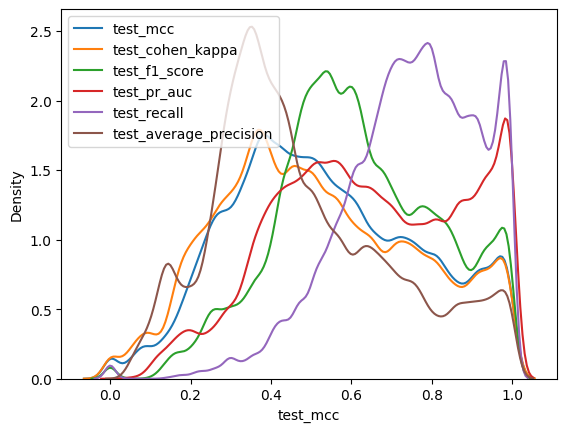

In [111]:
metrics = ['test_mcc', 'test_cohen_kappa', 'test_f1_score', 'test_pr_auc', 'test_recall',
       'test_average_precision']
for m in metrics:
    sns.kdeplot(rdf, x=m, bw_adjust=0.5)
plt.legend(metrics)

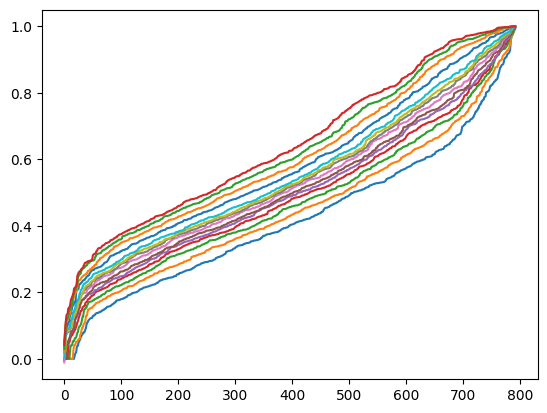

In [112]:
for k in rdf.index.get_level_values('k').unique().values:
    plt.plot(rdf.query('k==@k').sort_values('test_mcc').test_mcc.values, label=k)

<AxesSubplot: xlabel='test_mcc', ylabel='Density'>

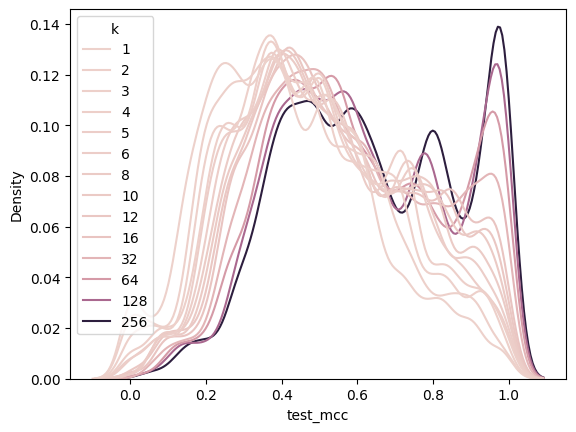

In [98]:
import matplotlib.colors as colors

# make kde density tighter
sns.kdeplot(data=rdf, x='test_mcc', hue='k',bw_adjust=0.5)

In [65]:

rdf

test_mcc test_cohen_kappa  \
feature        layer aggregation hook_loc      k                                
all_Gender_Fem 0     none        mlp.hook_post 1      0.9897         0.989694   
                                               2      0.9897         0.989694   
                                               3      0.9897         0.989694   
                                               4    0.993171         0.993148   
                                               5         1.0              1.0   
...                                                      ...              ...   
all_upos_X     5     none        mlp.hook_post 16   0.697441         0.685852   
                                               32   0.708643         0.696682   
                                               64   0.725362         0.713166   
                                               128  0.755679         0.746372   
                                               256  0.784994         0.778717   

                                                    test_fmi test_f1_score  \
feature        layer aggregation hook_loc      k                             
all_Gender_Fem 0     none        mlp.hook_post 1    0.990886      0.990881   
                                               2    0.990886      0.990881   
                                               3    0.990886      0.990881   
                                               4    0.993958      0.993939   
                                               5         1.0           1.0   
...                                                      ...           ...   
all_upos_X     5     none        mlp.hook_post 16   0.757417      0.749436   
                                               32   0.766332      0.758132   
                                               64   0.779572      0.771263   
                                               128  0.803167      0.796834   
                                               256  0.826093      0.821816   

                                                   test_f0.5_score  \
feature        layer aggregation hook_loc      k                     
all_Gender_Fem 0     none        mlp.hook_post 1          0.989078   
                                               2          0.989078   
                                               3          0.989078   
                                               4          0.990338   
                                               5               1.0   
...                                                            ...   
all_upos_X     5     none        mlp.hook_post 16         0.689532   
                                               32          0.69711   
                                               64         0.709291   
                                               128        0.741104   
                                               256        0.774585   

                                                   test_f2_score test_pr_auc  \
feature        layer aggregation hook_loc      k                               
all_Gender_Fem 0     none        mlp.hook_post 1        0.992692    0.999852   
                                               2        0.992692    0.999926   
                                               3        0.992692    0.999926   
                                               4        0.997567         1.0   
                                               5             1.0         1.0   
...                                                          ...         ...   
all_upos_X     5     none        mlp.hook_post 16       0.820737    0.872315   
                                               32       0.830863    0.881833   
                                               64         0.8451    0.899699   
                                               128      0.861626    0.912559   
                                               256       0.87518    0.927683   

                               

In [71]:
verbose_features = []
for k in rdf.index.get_level_values('feature'):
    fname = k[4:]  # get rid of all
    next_token = False
    if fname[:len('next_token_')] == 'next_token_':
        fname = fname[len('next_token_'):]
        next_token = True
    fclass, ftype = fname.split('_')
    verbose_features.append((fclass, ftype, next_token))

# add verbose features to index of rdf
rdf.index = pd.MultiIndex.from_tuples(
    [k2 + k1[1:] for k1, k2 in zip(rdf.index.values.T.tolist(), verbose_features)],
    names=['feature_class', 'feature_type', 'next_token'] + rdf.index.names[1:])

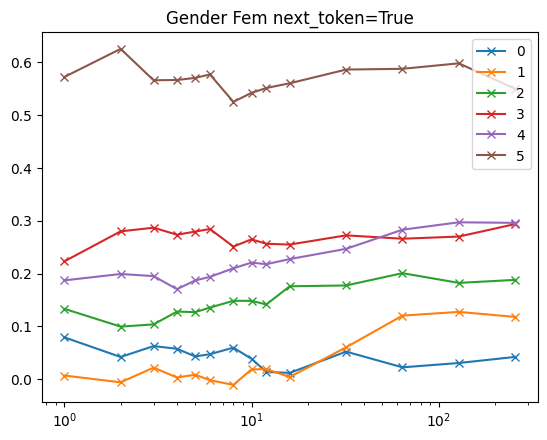

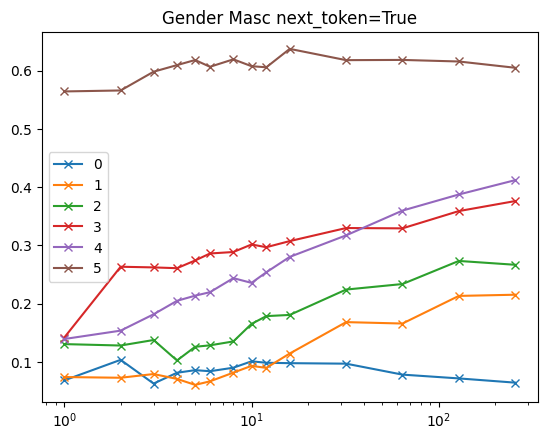

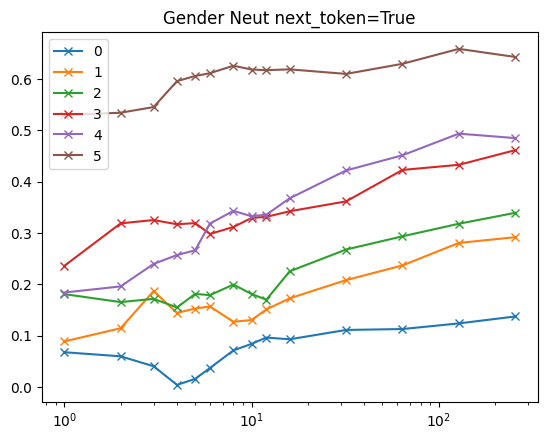

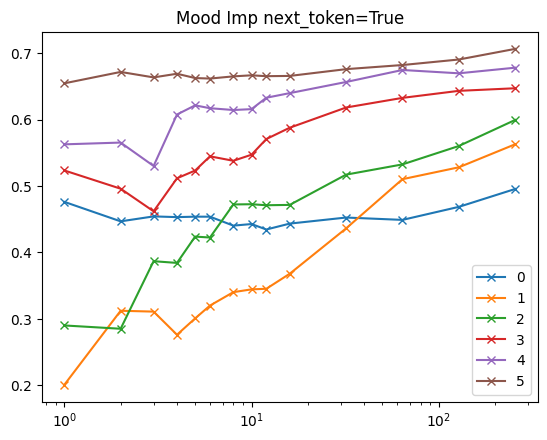

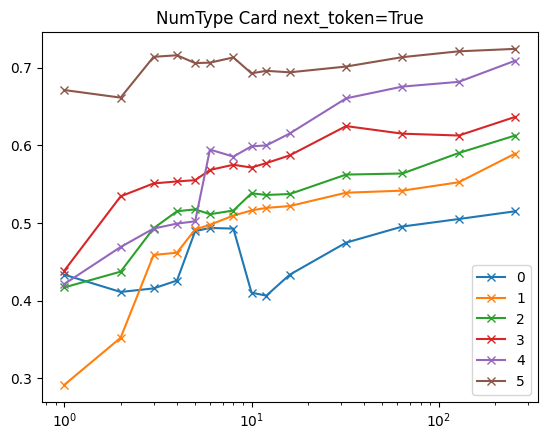

...

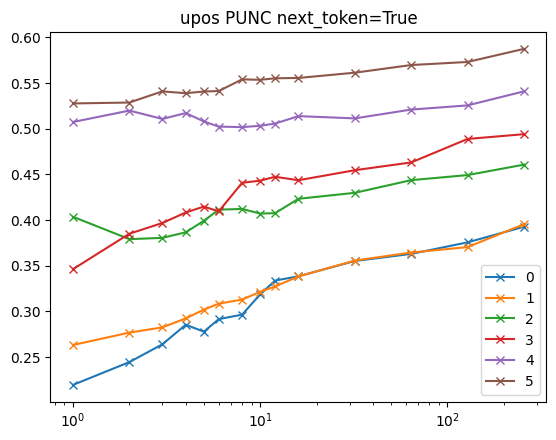

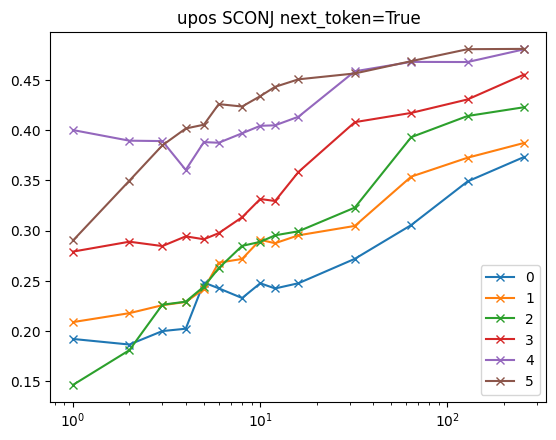

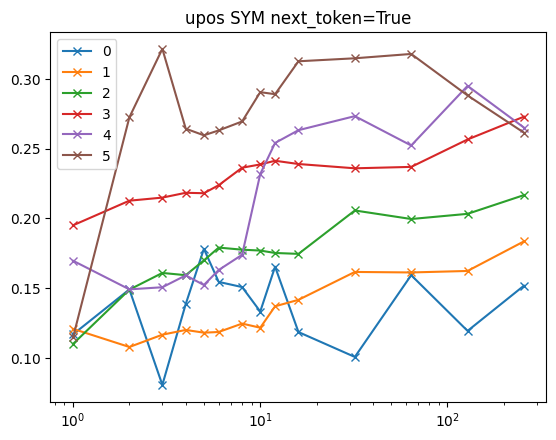

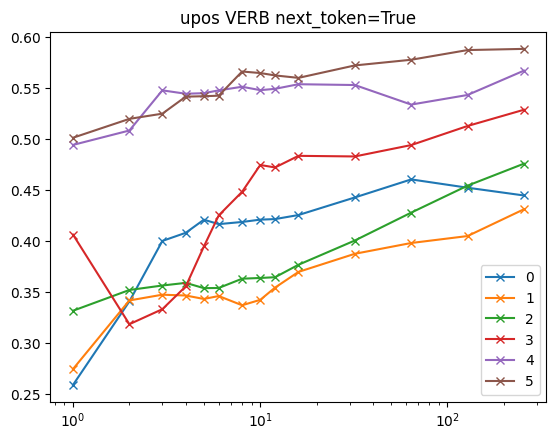

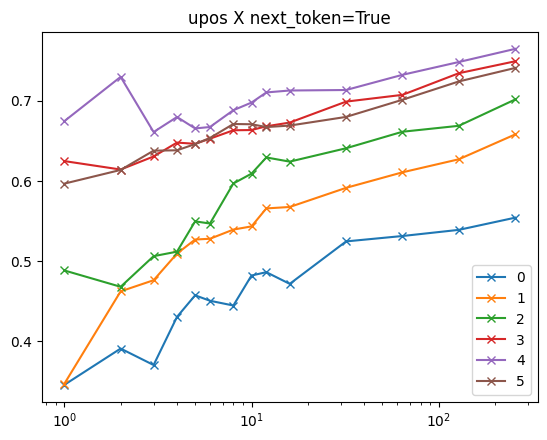

In [99]:
# for every feature_class, for every feature_type
# plot the test_f1_score as a function of k with a line per layer
for fclass in rdf.index.get_level_values('feature_class').unique():
    fclass_df = rdf.query('feature_class==@fclass')
    for ftype in fclass_df.index.get_level_values('feature_type').unique():
        for next_token in [True]:
            for layer in fclass_df.index.get_level_values('layer').unique():
                line_df = fclass_df.query('feature_type==@ftype and next_token==@next_token and layer==@layer').sort_values('k')
                plt.plot(line_df.index.get_level_values('k').values, line_df.test_mcc.values, label=layer, marker='x')
                plt.xscale('log')
            plt.title(f'{fclass} {ftype} next_token={next_token}')
            plt.legend()
            plt.show()